# Unit 5 - Financial Planning


In [15]:
# Initial imports
import os
import numpy as np 
import requests
import pandas as pd
from pandas import DataFrame
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

%matplotlib inline

In [16]:
# Load .env enviroment variables
load_dotenv()

True

## Part 1 - Personal Finance Planner

### Collect Crypto Prices Using the `requests` Library

In [17]:
# Set current amount of crypto assets
my_btc = 1.2
my_eth = 5.3

In [18]:
# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=CAD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=CAD"


In [120]:
# Fetch current BTC price
btc_price = requests.get(btc_url).json()
my_btc_value = btc_price ["data"]["1"]["quotes"]["USD"]["price"]

# Fetch current ETH price
eth_price = requests.get(eth_url).json()
my_eth_value = eth_price ["data"]["1027"]["quotes"]["USD"]["price"]

# Compute current value of my crpto
crypto_value = my_btc_value + my_eth_value
print (crypto_value)

# Print current crypto wallet balance
print(f"The current value of your {my_btc} BTC is ${my_btc_value:0.2f}")
print(f"The current value of your {my_eth} ETH is ${my_eth_value:0.2f}")

11717.42
The current value of your 1.2 BTC is $11349.85
The current value of your 5.3 ETH is $367.57


### Collect Investments Data Using Alpaca: `SPY` (stocks) and `AGG` (bonds)

In [20]:
# Current amount of shares
my_agg = 200
my_spy = 50


In [21]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

# Create the Alpaca API object
alpaca = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version="v2")

In [22]:
# Format current date as ISO format
today = pd.Timestamp("2020-10-15", tz="America/New_York").isoformat()

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

# Get current closing prices for SPY and AGG
df_portfolio = alpaca.get_barset(
    tickers,
    timeframe,
    start = today,
    end = today
).df

# Preview DataFrame
df_portfolio

AGG                                      SPY  \
                             open    high     low   close   volume    open   
2020-10-15 00:00:00-04:00  118.15  118.15  117.96  117.97  4988612  343.71   

                                                             
                             high     low   close    volume  
2020-10-15 00:00:00-04:00  348.02  343.13  347.51  50665477

In [23]:
# Pick AGG and SPY close prices
agg_close_price = 117.97
spy_close_price = 347.51

# Print AGG and SPY close prices
print(f"Current AGG closing price: ${agg_close_price}")
print(f"Current SPY closing price: ${spy_close_price}")

Current AGG closing price: $117.97
Current SPY closing price: $347.51


In [24]:
# Compute the current value of shares
my_agg_value = my_agg * agg_close_price
my_spy_value = my_spy * spy_close_price

# Print current value of share
print(f"The current value of your {my_spy} SPY shares is ${my_spy_value:0.2f}")
print(f"The current value of your {my_agg} AGG shares is ${my_agg_value:0.2f}")

The current value of your 50 SPY shares is $17375.50
The current value of your 200 AGG shares is $23594.00


### Savings Health Analysis

In [25]:
# Set monthly household income
monthly_income = 12000

# Create savings DataFrame
# YOUR CODE HERE!
crypto_value = my_btc_value + my_eth_value
shares_value = my_agg_value + my_spy_value
df_savings = pd.DataFrame ({"Product" : ["Crypto", "Shares"],
                            "Amount" : [crypto_value, shares_value]})

df_savings = df_savings.set_index ('Product')

# Display savings DataFrame
print (df_savings)

           Amount
Product          
Crypto   11715.71
Shares   40969.50


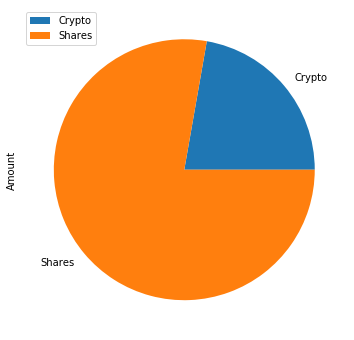

In [26]:
# Plot savings pie chart
Data = {"Crypto": [crypto_value], "Shares" : [shares_value]}
plot = df_savings.plot.pie (y = "Amount", subplots = True, figsize = (11,6))

In [63]:
# Set ideal emergency fund
emergency_fund = monthly_income * 3

# Calculate total amount of savings
df_savings = (crypto_value + shares_value)
print (df_savings)

# Validate saving health
df_savings = (crypto_value + shares_value)
emergency_fund = monthly_income * 3
shortfall = df_savings - emergency_fund
if df_savings >= emergency_fund:
    print ("Congratulations, you have enough money in  this fund.")
    print ("You need to increase your contribution by", shortfall)


52685.21
Congratulations, you have enough money in  this fund.
You need to increase your contribution by 16685.21


## Part 2 - Retirement Planning

### Monte Carlo Simulation

In [9]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-10-14', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-10-14', tz='America/New_York').isoformat()

In [24]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version = "v2"
)

In [85]:
# Set the tickers
tickers = ["AGG", "SPY"]
my_agg = 200
my_spy = 50

In [59]:
# Set timeframe to '5Y'
timeframe = "1D"

In [66]:
# Get 5 years' worth of historical data for SPY and AGG
df_portfolio = api.get_barset(
    tickers,
    timeframe,
    start = start_date,
    end = end_date
).df

# Display sample data
df_portfolio.head().dropna()

AGG                                       \
                             open      high       low   close   volume   
2015-10-14 00:00:00-04:00  109.83  110.0500  109.7251  110.03  3785661   
2015-10-15 00:00:00-04:00  109.93  110.0499  109.7900  109.89  1792325   
2015-10-16 00:00:00-04:00  109.90  109.9400  109.7800  109.78  1497588   
2015-10-19 00:00:00-04:00  109.78  109.8950  109.6500  109.85  1289942   
2015-10-20 00:00:00-04:00  109.64  109.7800  109.5500  109.65  1672562   

                              SPY                                      
                             open    high       low   close    volume  
2015-10-14 00:00:00-04:00  200.18  200.87  198.9400  199.27  82856686  
2015-10-15 00:00:00-04:00  200.08  202.34  199.6400  202.33  96008389  
2015-10-16 00:00:00-04:00  202.83  203.29  201.9200  203.14  79323870  
2015-10-19 00:00:00-04:00  202.50  203.37  202.1300  203.33  61255929  
2015-10-20 00:00:00-04:00  202.85  203.84  202.5471  203.07  60081395

In [84]:
# Configuring a Monte Carlo simulation to forecast 30 years cumulative returns
MC_thirtyyear = MCSimulation(
    portfolio_data = df_portfolio,
    weights = [.40,.60],
    num_simulation = 500,
    num_trading_days= 30*252
)
MC_thirtyyear

In [85]:
# Printing the simulation input data
print (MC_thirtyyear)

In [86]:
# Running a Monte Carlo simulation to forecast 30 years cumulative returns
MC_thirtyyear.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.994507,0.996519,0.998443,1.001812,0.997195,0.989027,0.997634,1.010774,0.992854,0.999973,...,0.993414,0.998280,1.002584,1.010812,0.997892,1.002638,1.000091,0.995538,1.007647,0.994073
2,0.994660,0.994239,0.993432,1.000909,0.994068,0.988423,1.006442,1.012106,0.980765,1.007664,...,0.988125,0.983416,1.013962,1.022393,0.994871,1.006168,1.011232,0.983638,1.002689,0.995183
3,0.982086,0.986393,1.001297,0.989344,0.984685,0.993378,1.004125,1.012831,0.968907,0.999942,...,0.988287,0.970972,1.012370,1.017879,0.986892,1.016229,1.015438,0.989599,1.004667,1.006260
4,0.982935,0.983706,0.995168,0.982285,0.978490,1.002482,1.021495,0.998440,0.977142,1.004031,...,0.990909,0.969231,1.008686,1.021727,0.988124,1.023654,1.015676,0.990422,1.007664,1.011825
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7556,15.595350,10.345585,8.069778,5.825828,17.139977,8.004002,9.749203,12.757302,9.072385,3.714697,...,2.354788,18.062613,4.115224,12.242115,3.407453,19.458135,20.830047,11.695792,9.253528,12.422120
7557,15.673810,10.380393,8.083695,5.801226,17.254938,7.961266,9.710554,12.636494,9.041444,3.713048,...,2.355958,17.933414,4.083422,12.071003,3.434846,19.614131,21.026687,11.654667,9.201342,12.392639
7558,15.646631,10.318750,8.042794,5.772938,17.352383,7.892429,9.808554,12.661056,8.881387,3.725338,...,2.329218,17.898289,4.102356,11.929592,3.445204,19.576864,21.138318,11.686312,9.266010,12.388329
7559,15.740847,10.257222,8.130447,5.702567,17.116253,7.957670,9.765190,12.702288,8.754852,3.742015,...,2.346732,17.973954,4.102589,12.030328,3.458687,19.816435,21.321672,11.897324,9.244090,12.245618


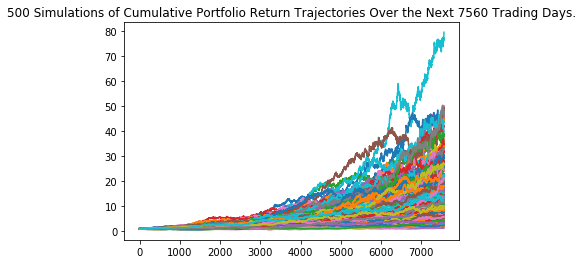

In [87]:
# Plot simulation outcomes
line_plot = MC_thirtyyear.plot_simulation()

# Save the plot for future usage
line_plot.get_figure().savefig("MC_thirtyyear_sim_plot.png", bbox_inches="tight")

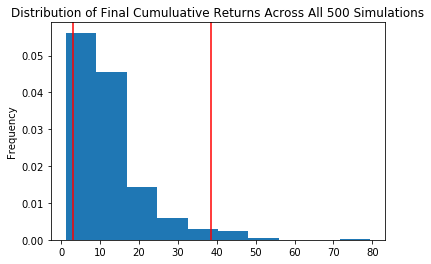

In [88]:
# Plot probability distribution and confidence intervals
dist_plot = MC_thirtyyear.plot_distribution()


### Retirement Analysis

In [89]:
# Fetch summary statistics from the Monte Carlo simulation results
tbl = MC_thirtyyear.summarize_cumulative_return()


# Print summary statistics
print(tbl)

count           500.000000
mean             12.491224
std               9.196156
min               1.170339
25%               6.387023
50%              10.299315
75%              15.414005
max              79.460831
95% CI Lower      3.023930
95% CI Upper     38.607632
Name: 7560, dtype: float64


### Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a `$20,000` initial investment.

In [90]:
# Set initial investment
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
ci_lower = round(tbl[8]*initial_investment,2)
ci_upper = round(tbl[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} and ${ci_upper}")

There is a 95% chance that an initial investment of $20000 in the portfolio over the next 30 years will end within in the range of $60478.61 and $772152.65


### Calculate the expected portfolio return at the `95%` lower and upper confidence intervals based on a `50%` increase in the initial investment.

In [91]:
# Set initial investment
initial_investment_2 = 20000 * 1.5

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $30,000
ci_lower = round(tbl[8]*initial_investment_2,2)
ci_upper = round(tbl[9]*initial_investment_2,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment_2} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} and ${ci_upper}")

There is a 95% chance that an initial investment of $30000.0 in the portfolio over the next 30 years will end within in the range of $90717.91 and $1158228.97


## Optional Challenge - Early Retirement


### Five Years Retirement Option

In [86]:
# Initial imports
import os
import numpy as np 
import requests
import pandas as pd
from pandas import DataFrame
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

%matplotlib inline

In [87]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-10-14', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-10-14', tz='America/New_York').isoformat()

In [100]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

# Create the Alpaca API object
api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version="v2")

In [101]:
# Set the tickers
tickers = ["AGG", "SPY"]
my_agg = 200
my_spy = 50

In [102]:
# Set timeframe to '5Y'
timeframe = "1D"

In [103]:
# Get 5 years' worth of historical data for SPY and AGG
df_portfolio = api.get_barset(
    tickers,
    timeframe,
    start = start_date,
    end = end_date
).df

# Display sample data
df_portfolio.head().dropna()

AGG                                       \
                             open      high       low   close   volume   
2015-10-14 00:00:00-04:00  109.83  110.0500  109.7251  110.03  3785661   
2015-10-15 00:00:00-04:00  109.93  110.0499  109.7900  109.89  1792325   
2015-10-16 00:00:00-04:00  109.90  109.9400  109.7800  109.78  1497588   
2015-10-19 00:00:00-04:00  109.78  109.8950  109.6500  109.85  1289942   
2015-10-20 00:00:00-04:00  109.64  109.7800  109.5500  109.65  1672562   

                              SPY                                      
                             open    high       low   close    volume  
2015-10-14 00:00:00-04:00  200.18  200.87  198.9400  199.27  82856686  
2015-10-15 00:00:00-04:00  200.08  202.34  199.6400  202.33  96008389  
2015-10-16 00:00:00-04:00  202.83  203.29  201.9200  203.14  79323870  
2015-10-19 00:00:00-04:00  202.50  203.37  202.1300  203.33  61255929  
2015-10-20 00:00:00-04:00  202.85  203.84  202.5471  203.07  60081395

In [104]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
MC_5year = MCSimulation(
    portfolio_data = df_portfolio,
    weights = [.40,.60],
    num_simulation = 500,
    num_trading_days= 5*252
)
MC_5year

In [105]:
# Display sample data
df_portfolio.head().dropna()

AGG                                       \
                             open      high       low   close   volume   
2015-10-14 00:00:00-04:00  109.83  110.0500  109.7251  110.03  3785661   
2015-10-15 00:00:00-04:00  109.93  110.0499  109.7900  109.89  1792325   
2015-10-16 00:00:00-04:00  109.90  109.9400  109.7800  109.78  1497588   
2015-10-19 00:00:00-04:00  109.78  109.8950  109.6500  109.85  1289942   
2015-10-20 00:00:00-04:00  109.64  109.7800  109.5500  109.65  1672562   

                              SPY                                      
                             open    high       low   close    volume  
2015-10-14 00:00:00-04:00  200.18  200.87  198.9400  199.27  82856686  
2015-10-15 00:00:00-04:00  200.08  202.34  199.6400  202.33  96008389  
2015-10-16 00:00:00-04:00  202.83  203.29  201.9200  203.14  79323870  
2015-10-19 00:00:00-04:00  202.50  203.37  202.1300  203.33  61255929  
2015-10-20 00:00:00-04:00  202.85  203.84  202.5471  203.07  60081395

In [106]:
# Printing the simulation input data
print (MC_5year)

In [107]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!
MC_5year.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.006571,0.992527,0.993878,1.010177,0.991743,0.999861,0.994771,0.989740,1.002895,1.001317,...,0.990490,0.992151,1.021421,0.994181,0.991599,1.003184,0.997962,0.995259,0.995741,1.014663
2,1.003272,0.996691,0.984539,1.018781,0.992163,0.996783,0.978952,0.991338,1.006820,0.995405,...,0.993008,0.984512,1.021978,0.990087,0.992682,0.999842,0.992015,1.008112,0.998452,1.020024
3,0.991743,1.001258,0.981182,0.999193,0.995467,1.007571,0.975511,0.997881,0.998605,0.985369,...,0.993988,0.979963,1.015241,0.983489,0.997451,0.989040,0.997900,1.026774,1.016162,1.028657
4,0.992682,1.000481,0.970399,0.995310,0.993825,1.012946,0.975259,0.990342,1.006328,0.988422,...,0.981118,0.978588,1.000879,0.985719,0.997932,0.983892,0.996330,1.026559,1.015816,1.023073
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,1.113647,1.982424,0.811842,1.642155,1.233313,1.923710,1.410535,1.887734,1.733049,1.139950,...,1.453416,1.470613,0.817635,1.919667,1.239561,1.035573,1.388170,1.259324,2.125215,1.409474
1257,1.111439,1.986612,0.808244,1.643239,1.252195,1.930481,1.381824,1.887585,1.740709,1.131270,...,1.461470,1.487923,0.821382,1.925088,1.240511,1.029297,1.408400,1.247261,2.159474,1.397446
1258,1.123772,1.978411,0.803733,1.644328,1.253389,1.923485,1.378509,1.878866,1.750798,1.115887,...,1.456219,1.494839,0.812563,1.938730,1.257590,1.034384,1.407430,1.235861,2.158572,1.378823
1259,1.122282,1.987901,0.810552,1.657425,1.250289,1.926065,1.376253,1.878090,1.757459,1.119409,...,1.471669,1.521789,0.803544,1.933639,1.263654,1.033585,1.402062,1.239066,2.141040,1.387235


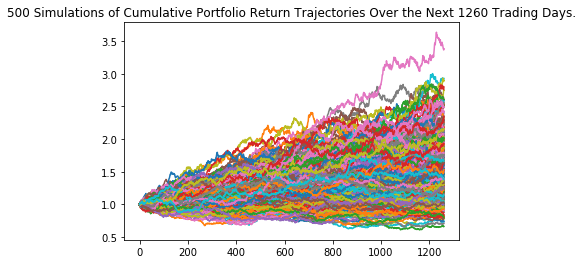

In [108]:
# Plot simulation outcomes
line_plot = MC_5year.plot_simulation()

# Save the plot for future usage
line_plot.get_figure().savefig("MC_5year_sim_plot.png", bbox_inches="tight")

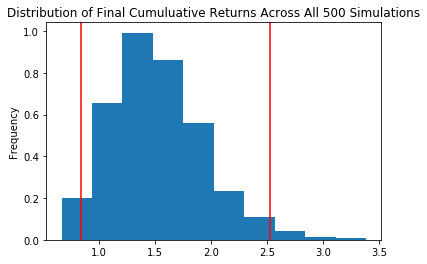

In [114]:
# Plot probability distribution and confidence intervals
dist_plot = MC_5year.plot_distribution()


In [115]:
# Fetch summary statistics from the Monte Carlo simulation results
tbl = MC_5year.summarize_cumulative_return()

# Print summary statistics
print (tbl)

count           500.000000
mean              1.525549
std               0.418562
min               0.663746
25%               1.227221
50%               1.479294
75%               1.764680
max               3.383952
95% CI Lower      0.834385
95% CI Upper      2.524419
Name: 1260, dtype: float64


In [117]:
# Set initial investment
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
ci_lower_five = round(tbl[8]*initial_investment,2)
ci_upper_five = round(tbl[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${ci_lower_five} and ${ci_upper_five}")

There is a 95% chance that an initial investment of $20000 in the portfolio over the next 5 years will end within in the range of $16687.69 and $50488.38
